In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

# Data cleaning

In [31]:
df = pd.read_csv("raw_data/serie_historica_acumulados_20200512.csv", encoding= 'unicode_escape')
df

,CCAA,FECHA,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
0,AN,20/2/2020,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,AR,20/2/2020,NaN,0.0,NaN,NaN,NaN,NaN,NaN
2,AS,20/2/2020,NaN,0.0,NaN,NaN,NaN,NaN,NaN
3,IB,20/2/2020,NaN,1.0,NaN,NaN,NaN,NaN,NaN
4,CN,20/2/2020,NaN,1.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
1562,*** Desde el día 11/04/2020 las cifras de hosp...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1563,*** Desde el día 12/04/2020 las cifras de UCIs...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1564,**** Desde el día 26/04/2020 las cifras de Hos...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1565,NOTA 3:Se excluyen de la serie las notificacio...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
df.tail(10)

,CCAA,FECHA,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
1557,RI,11/5/2020,NaN,4008.0,1384.0,1478.0,91.0,347.0,2749.0
1558,NOTA 1: El objetivo de los datos que se public...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1559,NOTA 2: Los datos de estas comunidades son dat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1560,* Desde el día 17/04/2020 las cifras de UCIs d...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1561,**Desde el día 28/04/2020 las cifras UCIs de ...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1562,*** Desde el día 11/04/2020 las cifras de hosp...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1563,*** Desde el día 12/04/2020 las cifras de UCIs...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1564,**** Desde el día 26/04/2020 las cifras de Hos...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1565,NOTA 3:Se excluyen de la serie las notificacio...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1566,NOTA 4: El total de PCR+ de Cataluña incluye 2...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
def toDelete(df):
    ind_delete = []
    info_notes = []
    for ind,i in enumerate(df.CCAA):
        if len(i)>3:
            ind_delete.append(ind)
            info_notes.append(i)

    return [ind_delete, info_notes]

In [34]:
#Drop the comment columns
ind_delete, notes_lst = toDelete(df)
df = df.drop(ind_delete,axis=0)

In [35]:
df.tail(5)

,CCAA,FECHA,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
1553,ML,11/5/2020,NaN,119.0,13.0,44.0,3.0,2.0,115.0
1554,MC,11/5/2020,NaN,1517.0,816.0,665.0,112.0,139.0,1819.0
1555,NC,11/5/2020,NaN,5081.0,2556.0,2039.0,135.0,493.0,3155.0
1556,PV,11/5/2020,NaN,13176.0,4664.0,6929.0,574.0,1429.0,14913.0
1557,RI,11/5/2020,NaN,4008.0,1384.0,1478.0,91.0,347.0,2749.0


In [36]:
notes_lst

['NOTA 1: El objetivo de los datos que se publican en esta web es saber el número de casos acumulados a la fecha y que por tanto no se puede deducir que la diferencia entre un día y el anterior es el número de casos nuevos ya que esos casos pueden haber sido recuperados de fechas anteriores. Cualquier inferencia que se haga sobre las diferencias de un día para otro deben hacerse con precaución y son únicamente la responsabilidad del autor.',
 'NOTA 2: Los datos de estas comunidades son datos de prevalencia (personas ingresadas a fecha de hoy). No reflejan el total de personas que han sido hospitalizadas o ingresadas en UCI\xa0 a lo largo del periodo de notificación(CL(UCIs*)-GA(UCIS**)-CM***-MD****)',
 '* Desde el día 17/04/2020 las cifras de UCIs de CL son casos acumulados. Previamente se refieren a personas ingresadas ese día.',
 '**Desde el día 28/04/2020 las cifras  UCIs de GA  son casos acumulados. Previamente se refieren a personas ingresadas ese día. Se actualizará la serie cuan

In [37]:
#Replace all NaN elements with 0s.
df = df.fillna(0)

In [38]:
df.CCAA.value_counts()

PV    82
VC    82
EX    82
NC    82
IB    82
CL    82
CT    82
MC    82
AS    82
ML    82
GA    82
AR    82
MD    82
RI    82
CN    82
CB    82
AN    82
CE    82
CM    82
Name: CCAA, dtype: int64

In [39]:
df.CCAA.value_counts().value_counts()

82    19
Name: CCAA, dtype: int64

In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1558 entries, 0 to 1557
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   CCAA            1558 non-null   object 
 1   FECHA           1558 non-null   object 
 2   CASOS           1558 non-null   float64
 3   PCR+            1558 non-null   float64
 4   TestAc+         1558 non-null   float64
 5   Hospitalizados  1558 non-null   float64
 6   UCI             1558 non-null   float64
 7   Fallecidos      1558 non-null   float64
 8   Recuperados     1558 non-null   float64
dtypes: float64(7), object(2)
memory usage: 121.7+ KB


In [41]:
ccaa = {
    'EX':'Extremadura',
    'MC':'Murcia',
    'NC':'Navarra',
    'AR':'Aragón',
    'RI':'Rioja',
    'CM':'Castilla-La Mancha',
    'AN':'Andalucia',
    'CB':'Cantabria',
    'PV':'País Vasco',
    'MD':'Madrid',
    'CN':'Canarias',
    'IB':'Islas Baleares',
    'AS':'Asturias',
    'CL':'Castilla y León',
    'CT':'Cataluña',
    'ML':'Melilla',
    'GA':'Galicia',
    'CE':'Ceuta',
    'VC':'Valencia',   
}

In [42]:
df_ccaa = pd.DataFrame([[key, ccaa[key]] for key in ccaa.keys()], columns=['abr', 'ccaa'])

In [43]:
df_ccaa = df_ccaa.sort_values('ccaa').reset_index(drop=True)

In [44]:
df_ccaa

,abr,ccaa
0,AN,Andalucia
1,AR,Aragón
2,AS,Asturias
3,CN,Canarias
4,CB,Cantabria
5,CL,Castilla y León
6,CM,Castilla-La Mancha
7,CT,Cataluña
8,CE,Ceuta
9,EX,Extremadura


In [45]:
colors = ['#EF9A9A','#F48FB1','#CE93D8','#B39DDB','#9FA8DA',
          '#90CAF9','#81D4FA','#80DEEA','#80CBC4','#A5D6A7',
          '#C5E1A5','#e6ee9c','#81c784','#ffe082','#ffcc80',
          '#ffab91','#bcaaa4','#b0bec5','#78909c']

In [46]:
df_ccaa["color"] = colors

In [47]:
df_ccaa

,abr,ccaa,color
0,AN,Andalucia,#EF9A9A
1,AR,Aragón,#F48FB1
2,AS,Asturias,#CE93D8
3,CN,Canarias,#B39DDB
4,CB,Cantabria,#9FA8DA
5,CL,Castilla y León,#90CAF9
6,CM,Castilla-La Mancha,#81D4FA
7,CT,Cataluña,#80DEEA
8,CE,Ceuta,#80CBC4
9,EX,Extremadura,#A5D6A7


In [48]:
df

,CCAA,FECHA,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
0,AN,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,AR,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,AS,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,IB,20/2/2020,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,CN,20/2/2020,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
1553,ML,11/5/2020,0.0,119.0,13.0,44.0,3.0,2.0,115.0
1554,MC,11/5/2020,0.0,1517.0,816.0,665.0,112.0,139.0,1819.0
1555,NC,11/5/2020,0.0,5081.0,2556.0,2039.0,135.0,493.0,3155.0
1556,PV,11/5/2020,0.0,13176.0,4664.0,6929.0,574.0,1429.0,14913.0


In [49]:
def giveMeCCAA(df_ccaa, df):
    name_ccaa = []
    color_ccaa = []
    for i in df.CCAA:
        for ind,e in enumerate(df_ccaa.abr):
            if i == e:
                name_ccaa.append(df_ccaa.ccaa[ind])
                color_ccaa.append(df_ccaa.color[ind])
    return name_ccaa, color_ccaa

In [50]:
name_ccaa, color_ccaa = giveMeCCAA(df_ccaa,df)

In [51]:
df["name"] = name_ccaa
df["color"] = color_ccaa

In [52]:
df

,CCAA,FECHA,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados,name,color
0,AN,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Andalucia,#EF9A9A
1,AR,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Aragón,#F48FB1
2,AS,20/2/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Asturias,#CE93D8
3,IB,20/2/2020,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Islas Baleares,#e6ee9c
4,CN,20/2/2020,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Canarias,#B39DDB
...,...,...,...,...,...,...,...,...,...,...,...
1553,ML,11/5/2020,0.0,119.0,13.0,44.0,3.0,2.0,115.0,Melilla,#ffe082
1554,MC,11/5/2020,0.0,1517.0,816.0,665.0,112.0,139.0,1819.0,Murcia,#ffcc80
1555,NC,11/5/2020,0.0,5081.0,2556.0,2039.0,135.0,493.0,3155.0,Navarra,#ffab91
1556,PV,11/5/2020,0.0,13176.0,4664.0,6929.0,574.0,1429.0,14913.0,País Vasco,#bcaaa4


In [53]:
dates = df.FECHA
dates = dates.to_list()

In [54]:
def obtainDate(lst):

    date = []
    for i in lst:
        t = i.split("/")
        for elem in range(2):
            t[elem] = t[elem].zfill(2)
        res=t[2]+"-"+t[1]+"-"+t[0]
        date.append(res)

    return date

In [55]:
new_date = obtainDate(dates)

In [56]:
df['date'] = new_date

In [57]:
dates_sort = df.FECHA.sort_values(ascending=True)
dates_sort = dates_sort.to_list()
dates_sort = list(dict.fromkeys(dates_sort))
dates_sort = sorted(dates_sort)
len(dates_sort)
dates_sort = obtainDate(dates_sort)
dates_sort.sort()
print(len(dates_sort))
print(dates_sort)

82
['2020-02-20', '2020-02-21', '2020-02-22', '2020-02-23', '2020-02-24', '2020-02-25', '2020-02-26', '2020-02-27', '2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06', '2020-03-07', '2020-03-08', '2020-03-09', '2020-03-10', '2020-03-11', '2020-03-12', '2020-03-13', '2020-03-14', '2020-03-15', '2020-03-16', '2020-03-17', '2020-03-18', '2020-03-19', '2020-03-20', '2020-03-21', '2020-03-22', '2020-03-23', '2020-03-24', '2020-03-25', '2020-03-26', '2020-03-27', '2020-03-28', '2020-03-29', '2020-03-30', '2020-03-31', '2020-04-01', '2020-04-02', '2020-04-03', '2020-04-04', '2020-04-05', '2020-04-06', '2020-04-07', '2020-04-08', '2020-04-09', '2020-04-10', '2020-04-11', '2020-04-12', '2020-04-13', '2020-04-14', '2020-04-15', '2020-04-16', '2020-04-17', '2020-04-18', '2020-04-19', '2020-04-20', '2020-04-21', '2020-04-22', '2020-04-23', '2020-04-24', '2020-04-25', '2020-04-26', '2020-04-27', '2020-04-28', '2020-04-29', '2020-04-30', '2

In [58]:
col_order = ['date','name','color','CASOS','PCR+','TestAc+','Hospitalizados','UCI','Fallecidos','Recuperados']
df_clean = df[col_order]

In [59]:
df_clean

,date,name,color,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
0,2020-02-20,Andalucia,#EF9A9A,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2020-02-20,Aragón,#F48FB1,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2020-02-20,Asturias,#CE93D8,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2020-02-20,Islas Baleares,#e6ee9c,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,2020-02-20,Canarias,#B39DDB,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
1553,2020-05-11,Melilla,#ffe082,0.0,119.0,13.0,44.0,3.0,2.0,115.0
1554,2020-05-11,Murcia,#ffcc80,0.0,1517.0,816.0,665.0,112.0,139.0,1819.0
1555,2020-05-11,Navarra,#ffab91,0.0,5081.0,2556.0,2039.0,135.0,493.0,3155.0
1556,2020-05-11,País Vasco,#bcaaa4,0.0,13176.0,4664.0,6929.0,574.0,1429.0,14913.0


# Figure
## Draw bar chart function

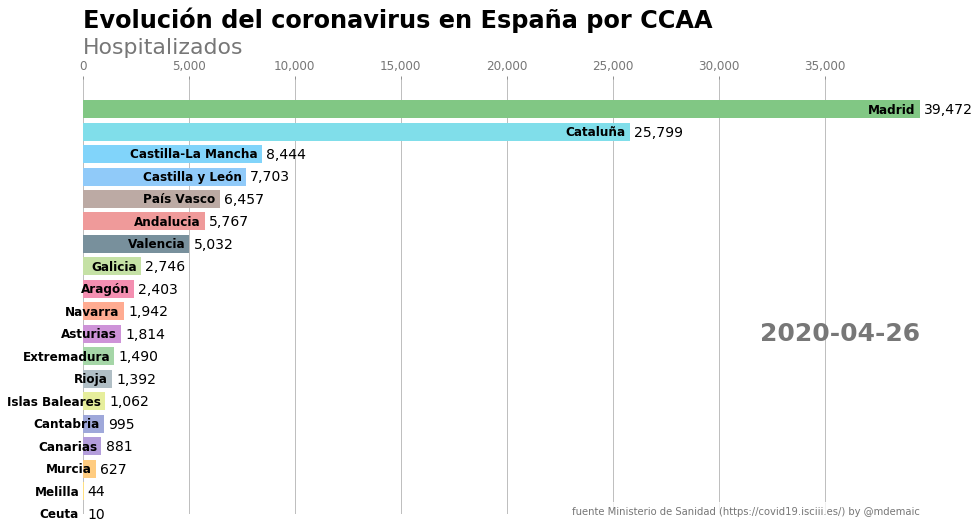

In [60]:
fig, ax = plt.subplots(figsize=(15, 8))

def draw_barchart(date,df,col):
    
    dff = df[df['date'].eq(date)].sort_values(by=col, ascending=True).tail(19)
    ax.clear()
    ax.barh(dff['name'], dff[col], color=dff['color'])
    dx = dff[col].max() / 200
    
    for i, (value, name) in enumerate(zip(dff[col], dff['name'])):
        ax.text(value-dx, i,     name,           size=12, weight=600, ha='right', va='center')
        ax.text(value+dx, i,     f"{value:,.0f}",  size=14, ha='left',  va='center')
    
    # ... polished styles
    ax.set_ylim(bottom=0)
    ax.text(1, 0.4, date, transform=ax.transAxes, color='#777777', size=25, ha='right', weight=800)
    ax.text(0, 1.06, col, transform=ax.transAxes, size=22, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, 'Evolución del coronavirus en España por CCAA',
            transform=ax.transAxes, size=24, weight=700, ha='left')
    ax.text(1, 0, 'fuente Ministerio de Sanidad (https://covid19.isciii.es/) by @mdemaic', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    plt.box(False)
    
draw_barchart('2020-04-26',df_clean,'Hospitalizados')
      

def draw_barchart_Casos(date):
    draw_barchart(date,df_clean,"CASOS")
    
def draw_barchart_PCR(date):
    draw_barchart(date,df_clean,"PCR+")

def draw_barchart_TestAc(date):
    draw_barchart(date,df_clean,"TestAc+")
    
def draw_barchart_Hospitalizados(date):
    draw_barchart(date,df_clean,"Hospitalizados")
    
def draw_barchart_UCI(date):
    draw_barchart(date,df_clean,"UCI")
    
def draw_barchart_Fallecidos(date):
    draw_barchart(date,df_clean,"Fallecidos")
    
def draw_barchart_Recuperados(date):
    draw_barchart(date,df_clean,"Recuperados")


In [61]:
def draw_animation(func):
    return animation.FuncAnimation(fig, func, frames=dates_sort)

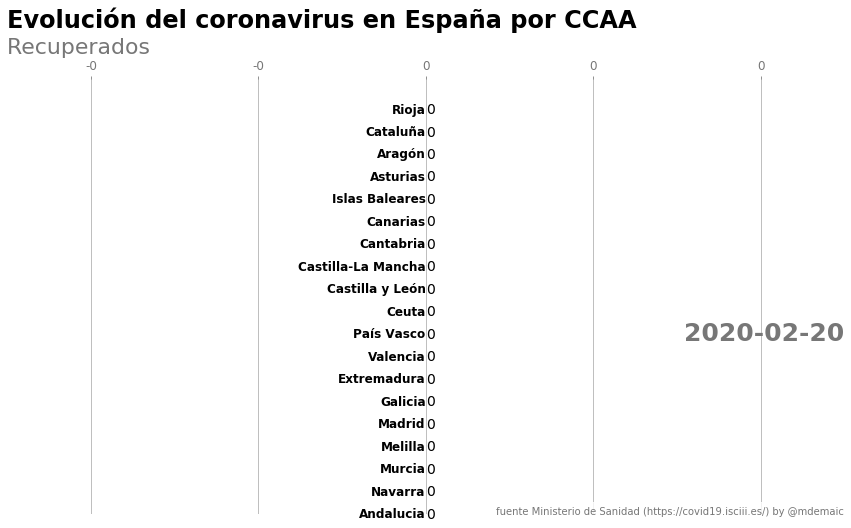

In [62]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_Recuperados)
HTML(animator.to_jshtml())

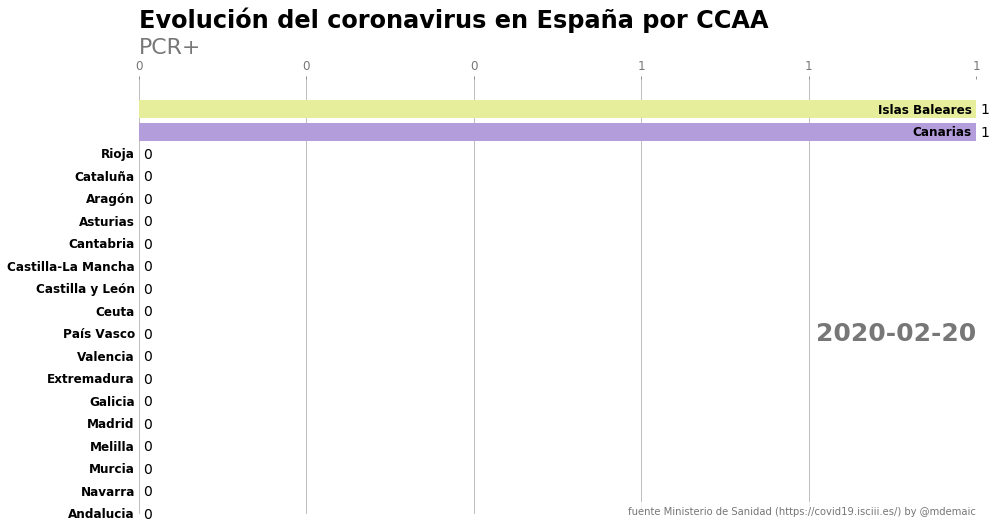

In [65]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_PCR)
HTML(animator.to_jshtml())

In [66]:
notes_lst

['NOTA 1: El objetivo de los datos que se publican en esta web es saber el número de casos acumulados a la fecha y que por tanto no se puede deducir que la diferencia entre un día y el anterior es el número de casos nuevos ya que esos casos pueden haber sido recuperados de fechas anteriores. Cualquier inferencia que se haga sobre las diferencias de un día para otro deben hacerse con precaución y son únicamente la responsabilidad del autor.',
 'NOTA 2: Los datos de estas comunidades son datos de prevalencia (personas ingresadas a fecha de hoy). No reflejan el total de personas que han sido hospitalizadas o ingresadas en UCI\xa0 a lo largo del periodo de notificación(CL(UCIs*)-GA(UCIS**)-CM***-MD****)',
 '* Desde el día 17/04/2020 las cifras de UCIs de CL son casos acumulados. Previamente se refieren a personas ingresadas ese día.',
 '**Desde el día 28/04/2020 las cifras  UCIs de GA  son casos acumulados. Previamente se refieren a personas ingresadas ese día. Se actualizará la serie cuan

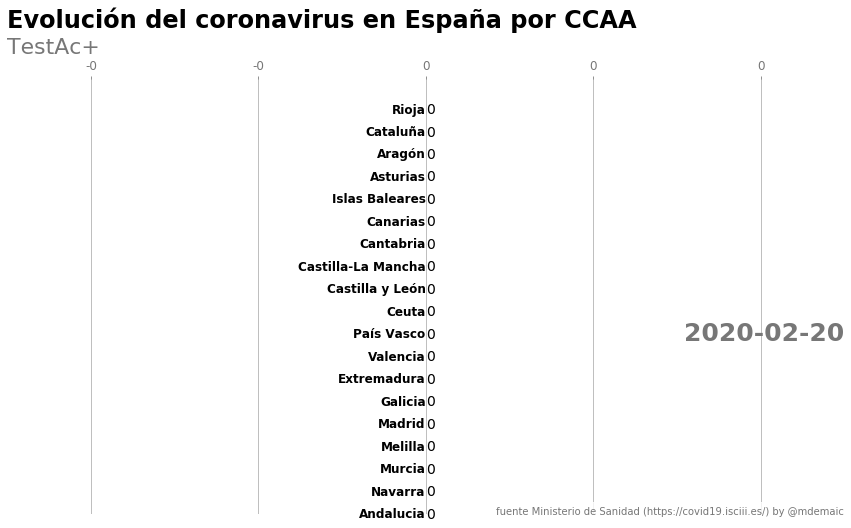

In [67]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_TestAc)
HTML(animator.to_jshtml())

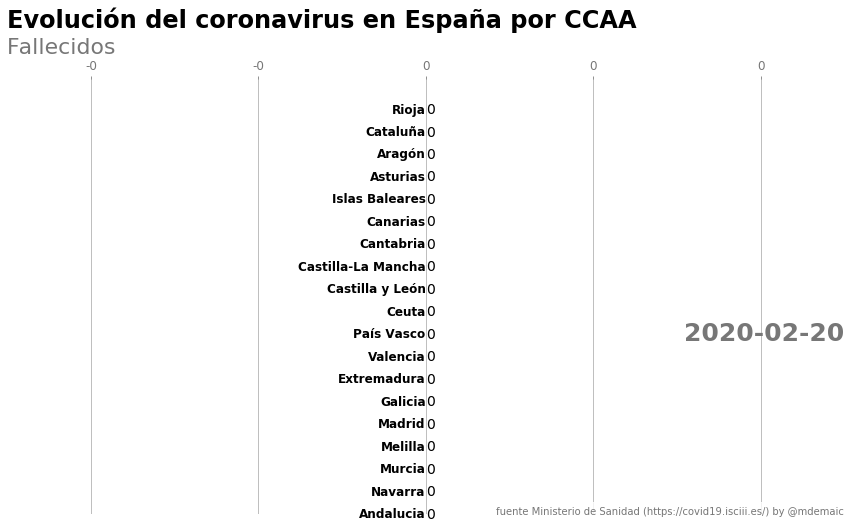

In [68]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_Fallecidos)
HTML(animator.to_jshtml())

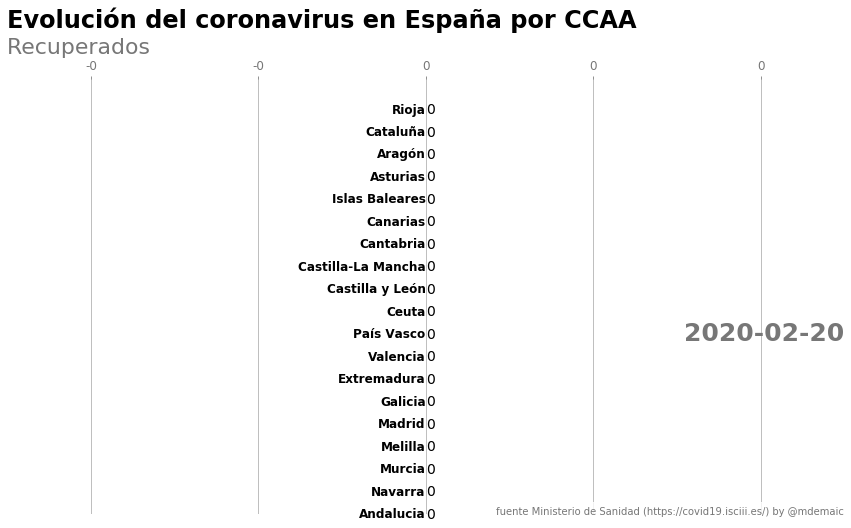

In [69]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_Recuperados)
HTML(animator.to_jshtml())

In [ ]:
fig, ax = plt.subplots(figsize=(15, 8))
animator = draw_animation(draw_barchart_UCI)
HTML(animator.to_jshtml())

In [63]:
df_clean_Madrid = df_clean[df_clean.name == "Madrid"]

In [64]:
df_clean_Madrid.tail(20)

,date,name,color,CASOS,PCR+,TestAc+,Hospitalizados,UCI,Fallecidos,Recuperados
1191,2020-04-22,Madrid,#81c784,0.0,60204.0,3393.0,7077.0,981.0,7684.0,33645.0
1210,2020-04-23,Madrid,#81c784,0.0,60627.0,3535.0,6601.0,949.0,7765.0,34212.0
1229,2020-04-24,Madrid,#81c784,0.0,61134.0,3691.0,6183.0,892.0,7848.0,34902.0
1248,2020-04-25,Madrid,#81c784,0.0,61364.0,3691.0,5892.0,873.0,7922.0,35367.0
1267,2020-04-26,Madrid,#81c784,0.0,61494.0,4022.0,39472.0,3309.0,7986.0,35565.0
1286,2020-04-27,Madrid,#81c784,0.0,62076.0,4205.0,39634.0,3338.0,8048.0,35841.0
1305,2020-04-28,Madrid,#81c784,0.0,62547.0,4381.0,39850.0,3355.0,8105.0,36314.0
1324,2020-04-29,Madrid,#81c784,0.0,62889.0,4488.0,40076.0,3377.0,8176.0,36707.0
1343,2020-04-30,Madrid,#81c784,0.0,63163.0,4609.0,40293.0,3392.0,8222.0,37154.0
1362,2020-05-01,Madrid,#81c784,0.0,63279.0,4609.0,40457.0,3404.0,8292.0,37530.0


In [34]:
col_Casos = ['date','name','CASOS']
col_PCR = ['date','name','PCR+']
col_TestAc = ['date','name','TestAc+']
col_Hospitalizados = ['date','name','Hospitalizados']
col_UCI = ['date','name','UCI']
col_Fallecidos = ['date','name','Fallecidos']
col_Recuperados = ['date','name','Recuperados']

df_Casos = df[col_Casos]
df_PCR = df[col_PCR]
df_TestAc = df[col_TestAc]
df_Hospitalizados = df[col_Hospitalizados]
df_UCI = df[col_UCI]
df_Fallecidos = df[col_Fallecidos]
df_Recuperados = df[col_Recuperados]

In [35]:
df_Casos

,date,name,CASOS
0,2020-02-20,Andalucia,0.0
1,2020-02-20,Aragón,0.0
2,2020-02-20,Asturias,0.0
3,2020-02-20,Islas Baleares,1.0
4,2020-02-20,Canarias,1.0
...,...,...,...
1306,2020-04-28,Melilla,0.0
1307,2020-04-28,Murcia,0.0
1308,2020-04-28,Navarra,0.0
1309,2020-04-28,País Vasco,0.0


In [36]:
df_Casos_20abr = df_Casos[df_Casos.date == "2020-04-20"]

In [37]:
df_Casos_20abr

,date,name,CASOS
1140,2020-04-20,Andalucia,0.0
1141,2020-04-20,Aragón,0.0
1142,2020-04-20,Asturias,0.0
1143,2020-04-20,Islas Baleares,0.0
1144,2020-04-20,Canarias,0.0
1145,2020-04-20,Cantabria,0.0
1146,2020-04-20,Castilla-La Mancha,0.0
1147,2020-04-20,Castilla y León,0.0
1148,2020-04-20,Cataluña,0.0
1149,2020-04-20,Ceuta,0.0


In [38]:
Casos = pd.pivot_table(df_Casos, values='CASOS', index='date',
                    columns=['name'], aggfunc=np.sum, fill_value=0)

In [39]:
Casos

name,Andalucia,Aragón,Asturias,Canarias,Cantabria,Castilla y León,Castilla-La Mancha,Cataluña,Ceuta,Extremadura,Galicia,Islas Baleares,Madrid,Melilla,Murcia,Navarra,País Vasco,Rioja,Valencia
date,,,,,,,,,,,,,,,,,,,
2020-02-20,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2020-02-21,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2020-02-22,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2020-02-23,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2020-02-24,0,0,0,2,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-04-24,0,0,0,0,0,0,0,0,0,0,9116,0,0,0,0,0,0,0,0
2020-04-25,0,0,0,0,0,0,0,0,0,0,9176,0,0,0,0,0,0,0,0
2020-04-26,0,0,0,0,0,0,0,0,0,0,9238,0,0,0,0,0,0,0,0
